In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns

In [2]:
# *data pre-processing* using sklearn
from sklearn.preprocessing import StandardScaler, LabelEncoder

from sklearn.model_selection import train_test_split

# model selection
from sklearn.ensemble import RandomForestClassifier

# metrics evaluation
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [3]:
df = pd.read_csv('AS24_Case_Study_Data.csv', delimiter=";")
df.head()

,article_id,product_tier,make_name,price,first_zip_digit,first_registration_year,created_date,deleted_date,search_views,detail_views,stock_days,ctr
0,350625839,Basic,Mitsubishi,16750,5,2013,24.07.18,24.08.18,3091.0,123.0,30,0.03780329990294403
1,354412280,Basic,Mercedes-Benz,35950,4,2015,16.08.18,07.10.18,3283.0,223.0,52,0.06792567773378008
2,349572992,Basic,Mercedes-Benz,11950,3,1998,16.07.18,05.09.18,3247.0,265.0,51,0.0816137973514013
3,350266763,Basic,Ford,1750,6,2003,20.07.18,29.10.18,1856.0,26.0,101,0.014008620689655173
4,355688985,Basic,Mercedes-Benz,26500,3,2014,28.08.18,08.09.18,490.0,20.0,12,0.04081632653061224


In [4]:
df['product_tier'].value_counts()

Basic      75421
Premium     2324
Plus         576
Name: product_tier, dtype: int64

In [5]:
df.columns

Index(['article_id', 'product_tier', 'make_name', 'price', 'first_zip_digit',
       'first_registration_year', 'created_date', 'deleted_date',
       'search_views', 'detail_views', 'stock_days', 'ctr'],
      dtype='object')

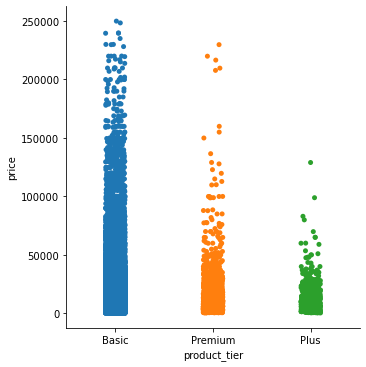

In [6]:
sns.catplot(x = 'product_tier', y = 'price', data = df)

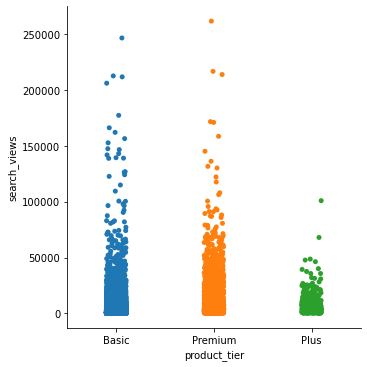

In [7]:
sns.catplot(x = 'product_tier', y = 'search_views', data = df.query("search_views < 300000"))

In [8]:
##################
#will be discusssed asfter evaluation
################

# correlation_mat = df.corr()

# sns.heatmap(correlation_mat, annot = True)

# plt.title("Correlation matrix of Breast Cancer data", y=-0.75)

# plt.xlabel("features")

# plt.ylabel("features")

# plt.show()

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78321 entries, 0 to 78320
Data columns (total 12 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   article_id               78321 non-null  int64  
 1   product_tier             78321 non-null  object 
 2   make_name                78321 non-null  object 
 3   price                    78321 non-null  int64  
 4   first_zip_digit          78321 non-null  int64  
 5   first_registration_year  78321 non-null  int64  
 6   created_date             78321 non-null  object 
 7   deleted_date             78321 non-null  object 
 8   search_views             78311 non-null  float64
 9   detail_views             78311 non-null  float64
 10  stock_days               78321 non-null  int64  
 11  ctr                      78297 non-null  object 
dtypes: float64(2), int64(5), object(5)
memory usage: 7.2+ MB


In [10]:
df.dropna(inplace = True)  # remove NaN values

In [11]:
X = df.drop(['article_id', 'product_tier', 'first_zip_digit', 'created_date', 'deleted_date', 'make_name', 'first_registration_year', "ctr"], axis=1)
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 78297 entries, 0 to 78320
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   price         78297 non-null  int64  
 1   search_views  78297 non-null  float64
 2   detail_views  78297 non-null  float64
 3   stock_days    78297 non-null  int64  
dtypes: float64(2), int64(2)
memory usage: 3.0 MB


In [12]:
## caution for :dropna()  ::  Drop the column with extremy high number of NaN values

In [13]:
X.head(11)

,price,search_views,detail_views,stock_days
0,16750,3091.0,123.0,30
1,35950,3283.0,223.0,52
2,11950,3247.0,265.0,51
3,1750,1856.0,26.0,101
4,26500,490.0,20.0,12
5,24890,125.0,6.0,2
6,2850,172.0,4.0,1
7,23740,1499.0,99.0,87
8,7850,4329.0,133.0,75
9,13950,2257.0,89.0,32


In [14]:
df['product_tier'].value_counts()

Basic      75397
Premium     2324
Plus         576
Name: product_tier, dtype: int64

In [15]:
le = LabelEncoder()
df['product_tier'] = le.fit_transform(df['product_tier'])


In [16]:
df['product_tier'].value_counts()

0    75397
2     2324
1      576
Name: product_tier, dtype: int64

In [17]:
y = df['product_tier']

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)  

# 80% data is for training, 20% for testing

# how to choose: bigger the data lower the testing size

### to deal with imbalanced classification data
we can see that the data is very imbalanced (towards basic tier).
Without balancing, the model will overfit "Basic" tier and underfit "Plus" tier.
#### need to balance the data. We will be using imblearn.

In [19]:
from imblearn.under_sampling import RandomUnderSampler

In [20]:
rus = RandomUnderSampler()
X_resampled, y_resampled = rus.fit_resample(X_train, y_train)

In [21]:
pd_y = pd.Series(y_resampled)
pd_y.value_counts()

0    446
1    446
2    446
Name: product_tier, dtype: int64

In [22]:
sc = StandardScaler()

X_train = sc.fit_transform(X_resampled)    
X_test = sc.transform(X_test)

###### look at in two steps :

#1) calculate the mean and standard deviation of the data  (fit)
#2) transform the data values as: (X - X_mean) / X_std : 



## this resut in values with mean = 0 , std = 1

In [23]:
X_train.shape

(1338, 4)

# Different Model Fitting

## RandomForestClassifier

In [24]:
rfc = RandomForestClassifier()
rfc.fit(X_train, y_resampled)


############ Arguments########
# https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
# 1) max_features: default: “auto” (means use all the features)  “sqrt”  (sqrt of # features) example 
# n_estimators (trees): default = 100 
#example: 9 features, max_features: sqrt: it will use 3 features


RandomForestClassifier()

# Metrics Evaluation

In [25]:
pred_rfc = rfc.predict(X_test)

In [35]:
rfc

RandomForestClassifier()

In [26]:
pred_rfc.shape

(15660,)

In [27]:
y_test.shape

(15660,)

In [28]:
from sklearn.model_selection import cross_val_score
y_score = cross_val_score(rfc,X_test, y_test)


array([[ 0.45229639, -0.41595298, -0.4957619 ,  0.54839224],
       [-0.33921068, -0.55268854, -0.63144203, -0.4692257 ],
       [ 0.45229639, -0.18969096, -0.34181714,  0.29398776],
       ...,
       [-0.31845955, -0.36354156, -0.41226644, -0.24662178],
       [ 2.40586626, -0.48645604, -0.36269101, -0.78723131],
       [-0.11984168, -0.55098032, -0.63144203, -0.1512201 ]])

In [29]:
# metrics evaluation
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

In [30]:
# RandomForestClassifier
print(accuracy_score(y_test, pred_rfc))
#print(confusion_matrix(y_test, pred_rfc))
# sns.heatmap(confusion_matrix(y_test, pred_rfc)) # not of much use since num data is skewed

0.7521072796934866


In [31]:
confusion_matrix(y_test, pred_rfc)

array([[11364,  3026,   636],
       [   20,    73,    37],
       [   32,   131,   341]])

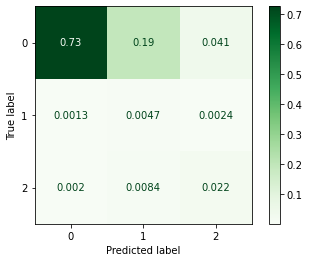

In [44]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(rfc,X_test, y_test, normalize = 'all', cmap='Greens')

In [32]:
print(classification_report(y_test, pred_rfc))

              precision    recall  f1-score   support

           0       1.00      0.76      0.86     15026
           1       0.02      0.56      0.04       130
           2       0.34      0.68      0.45       504

    accuracy                           0.75     15660
   macro avg       0.45      0.66      0.45     15660
weighted avg       0.97      0.75      0.84     15660



In [33]:
from sklearn import metrics

In [34]:
fpr, tpr, thresholds = metrics.roc_curve(pred_rfc, accuracy_score(y_test, pred_rfc), pos_label=2)
roc_auc = metrics.auc(fpr, tpr)
plt.figure()
plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

TypeError: Singleton array 0.7521072796934866 cannot be considered a valid collection.

In [ ]:
total number of wines: 1000
red wines = 300   : 1
white wines = 700 : 0

In [134]:

#        1   0
#   1 [[300, 0]

#   0 [0, 700]]

[[300, 0], [0, 700]]

In [136]:
#      1        0
#  1 [200     100]

#  0 [150     550]

##### PRECISION
#precision 1:  200 / (200 + 150) (precisiomn for red wines)

        # total number of predicted red wines: 350 out of which 200 predictions are correct 
    
#precision 2:  550 / (100 + 550) (precisiomn for white wines)

        # total number of predicted white wines: 650 out of which 550 predictions are correct     
## ACCURACY OUT OF PREDICTIONS  
       
#### RECALL

#recall 1: 200 / (200 + 100) (recall of red wines)
        # total number of actual red wines are 300 out of which 200 are corectly predicted
    
#recall 2: 550 / (150 + 550) (recall of white wines)
        # total number of actual white wines are 700 out of which 550 are corectly predicted

#COMBINED WAY :

# F1-score: combination of precision and recall: 2*(P*R)/(P+R)

# kind of an average of P and R



In [25]:

############## Gini impurity #######
red   : 4/17 
green : 13/17
    
impurity = 1 - red**2 - green**2  : x 

    x = .2
# red : 17/17
#green : 0/17 
    
impurity = 0

##########

Information gain :
    
new_impurity from new subdatasets


new_impurity = .1

Information gain = impurity - new_impurity  = .1


keep splitting until Information gain < 0, ir does not mean that the sub dataset has impurity =0

in final split : which category is the majority: the leaf will be labelled as that paricular label: THE LEAF
            
            

            
20 white wine:
    
    ## Tree 1: predicts : 18 white
    ## Tree 2:   : 12 white
    conclusion: tree 1 is better
        

        
        
20 red wines:
    ## tree 1 : 12 red
    ## tree 2: 16 red wines
    
    conclusion : tree 2 is better
        
        
        
best make 100 trees:
    
    majority vote: 
        










SyntaxError: invalid syntax (<ipython-input-25-2201b43734a1>, line 4)